In [ ]:
import tensorflow as tf
import matplotlib.image as img
%matplotlib inline
import numpy as np
from collections import defaultdict
import collections
from shutil import copy
from shutil import copytree, rmtree
import tensorflow as tfs
from tensorflow.keras.preprocessing import image
import matplotlib.pyplot as plt
import numpy as np
import os
import random
from tensorflow.keras import layers, losses, optimizers, Model


# 1. EXTRACTING AND LOADING THE DATA


In [ ]:
import os
# Helper function to download data and extract
def get_data_extract():
  if "food-101" in os.listdir():
    print("Dataset already exists")
  else:
    print("Downloading the data...")
    !wget http://data.vision.ee.ethz.ch/cvl/food-101.tar.gz
    print("Dataset downloaded!")
    print("Extracting data..")
    !tar xzvf food-101.tar.gz
    print("Extraction done!")

In [ ]:
get_data_extract()

Streaming output truncated to the last 5000 lines.
food-101/images/cannoli/1767088.jpg
food-101/images/cannoli/3201965.jpg
food-101/images/cannoli/3778102.jpg
food-101/images/cannoli/2674065.jpg
food-101/images/cannoli/1169899.jpg
food-101/images/cannoli/1378086.jpg
food-101/images/cannoli/803909.jpg
food-101/images/cannoli/1067240.jpg
food-101/images/cannoli/3002709.jpg
food-101/images/cannoli/2612632.jpg
food-101/images/cannoli/3627612.jpg
food-101/images/cannoli/1798703.jpg
food-101/images/cannoli/560632.jpg
food-101/images/cannoli/512468.jpg
food-101/images/cannoli/2331523.jpg
food-101/images/cannoli/3118302.jpg
food-101/images/cannoli/1499412.jpg
food-101/images/cannoli/1557459.jpg
food-101/images/cannoli/146566.jpg
food-101/images/cannoli/96922.jpg
food-101/images/cannoli/1699562.jpg
food-101/images/cannoli/730051.jpg
food-101/images/cannoli/2177977.jpg
food-101/images/cannoli/2767028.jpg
food-101/images/cannoli/6564.jpg
food-101/images/cannoli/553447.jpg
food-101/images/cannoli/

# 2. INSPECTING THE FILES

In [ ]:
# Check the extracted dataset folder
!ls food-101/

images	license_agreement.txt  meta  README.txt


In [ ]:
os.listdir('food-101/images')

['ravioli',
 'breakfast_burrito',
 'spring_rolls',
 'baklava',
 'french_onion_soup',
 'risotto',
 'pho',
 'strawberry_shortcake',
 'tacos',
 'scallops',
 'spaghetti_carbonara',
 'caesar_salad',
 'grilled_salmon',
 'bruschetta',
 'ceviche',
 'cheesecake',
 'takoyaki',
 'foie_gras',
 'seaweed_salad',
 'cannoli',
 'apple_pie',
 'huevos_rancheros',
 'tiramisu',
 'dumplings',
 'frozen_yogurt',
 'omelette',
 'cup_cakes',
 'chocolate_cake',
 'samosa',
 'hummus',
 'clam_chowder',
 'pad_thai',
 'edamame',
 'creme_brulee',
 'gnocchi',
 'chicken_wings',
 'beef_tartare',
 'beignets',
 'peking_duck',
 'garlic_bread',
 'churros',
 'hot_dog',
 'beet_salad',
 'gyoza',
 'greek_salad',
 'bread_pudding',
 'pancakes',
 'chicken_curry',
 'bibimbap',
 'donuts',
 'fried_calamari',
 'chicken_quesadilla',
 'pulled_pork_sandwich',
 'panna_cotta',
 'mussels',
 'onion_rings',
 'filet_mignon',
 'french_toast',
 'macarons',
 'lobster_bisque',
 'red_velvet_cake',
 'fried_rice',
 'oysters',
 'tuna_tartare',
 'miso_so

In [ ]:
with open('food-101/meta/classes.txt', 'r') as file:
  lines = file.readlines()
labels = []

for line in lines:
  labels.append(line.strip())

len(labels)

101

In [ ]:
os.listdir('food-101/meta')

['labels.txt',
 'train.json',
 'test.json',
 'train.txt',
 'test.txt',
 'classes.txt']

In [ ]:
!head food-101/meta/train.txt

apple_pie/1005649
apple_pie/1014775
apple_pie/1026328
apple_pie/1028787
apple_pie/1043283
apple_pie/1050519
apple_pie/1057749
apple_pie/1057810
apple_pie/1072416
apple_pie/1074856


In [ ]:
!head food-101/meta/classes.txt

apple_pie
baby_back_ribs
baklava
beef_carpaccio
beef_tartare
beet_salad
beignets
bibimbap
bread_pudding
breakfast_burrito


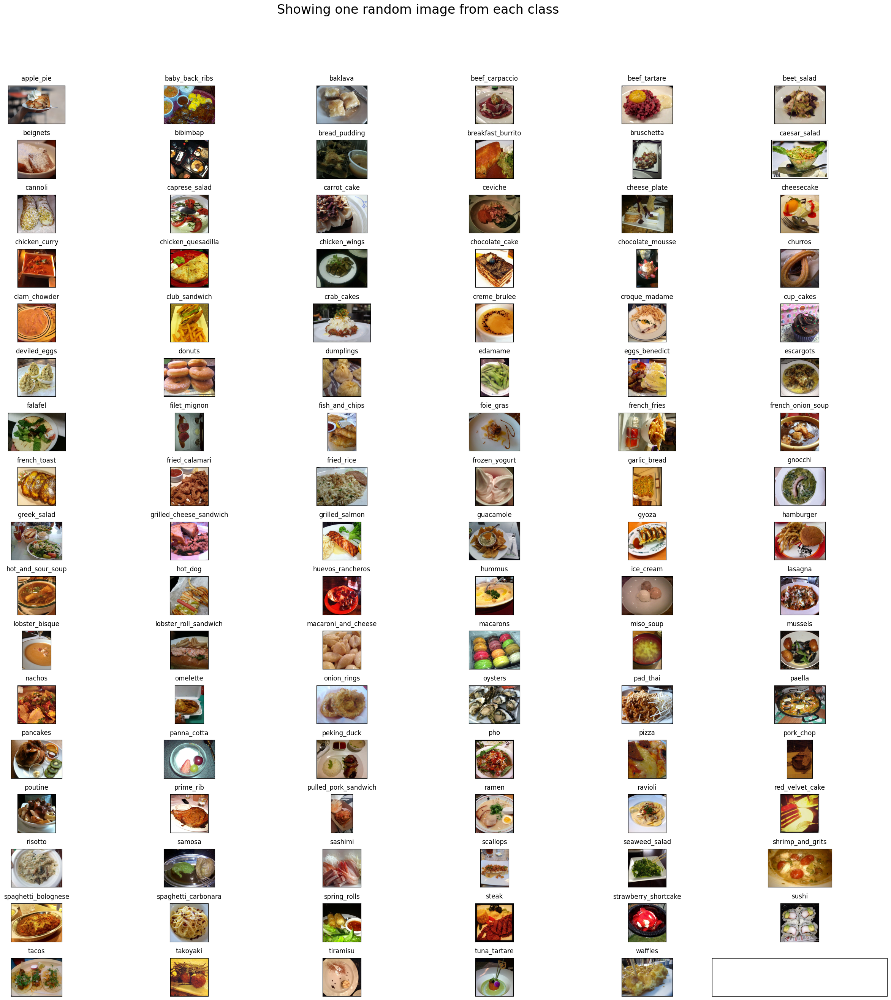

In [ ]:
from matplotlib import pyplot as plt
import numpy as np
# Visualize the data, showing one image per class from 101 classes
rows = 17
cols = 6
fig, ax = plt.subplots(rows, cols, figsize=(25,25))
fig.suptitle("Showing one random image from each class", y=1.05, fontsize=24) # Adding  y=1.05, fontsize=24 helped me fix the suptitle overlapping with axes issue
data_dir = "food-101/images/"
foods_sorted = sorted(os.listdir(data_dir))
food_id = 0
for i in range(rows):
  for j in range(cols):
    try:
      food_selected = foods_sorted[food_id]
      food_id += 1
    except:
      break
    if food_selected == '.DS_Store':
        continue
    food_selected_images = os.listdir(os.path.join(data_dir,food_selected)) # returns the list of all files present in each food category
    food_selected_random = np.random.choice(food_selected_images) # picks one food item from the list as choice, takes a list and returns one random item
    img = plt.imread(os.path.join(data_dir,food_selected, food_selected_random))
    ax[i][j].imshow(img)
    ax[i][j].set_title(food_selected, pad = 10)

plt.setp(ax, xticks=[],yticks=[])
plt.tight_layout()
# https://matplotlib.org/users/tight_layout_guide.html

In [ ]:
# Helper method to split dataset into train and test folders
def prepare_data(filepath, src,dest):
  classes_images = defaultdict(list)
  with open(filepath, 'r') as txt:
      paths = [read.strip() for read in txt.readlines()]
      for p in paths:
        food = p.split('/')
        classes_images[food[0]].append(food[1] + '.jpg')

  for food in classes_images.keys():
    print("\nCopying images into ",food)
    if not os.path.exists(os.path.join(dest,food)):
      os.makedirs(os.path.join(dest,food))
    for i in classes_images[food]:
      copy(os.path.join(src,food,i), os.path.join(dest,food,i))
  print("Copying Done!")

In [ ]:
# Prepare train dataset by copying images from food-101/images to food-101/train using the file train.txt
# %cd '/content/drive/MyDrive/CNN project'
print("Creating train data...")
prepare_data('/content/food-101/meta/train.txt', '/content/food-101/images', 'train')

Creating train data...

Copying images into  apple_pie

Copying images into  baby_back_ribs

Copying images into  baklava

Copying images into  beef_carpaccio

Copying images into  beef_tartare

Copying images into  beet_salad

Copying images into  beignets

Copying images into  bibimbap

Copying images into  bread_pudding

Copying images into  breakfast_burrito

Copying images into  bruschetta

Copying images into  caesar_salad

Copying images into  cannoli

Copying images into  caprese_salad

Copying images into  carrot_cake

Copying images into  ceviche

Copying images into  cheesecake

Copying images into  cheese_plate

Copying images into  chicken_curry

Copying images into  chicken_quesadilla

Copying images into  chicken_wings

Copying images into  chocolate_cake

Copying images into  chocolate_mousse

Copying images into  churros

Copying images into  clam_chowder

Copying images into  club_sandwich

Copying images into  crab_cakes

Copying images into  creme_brulee

Copying im

In [ ]:
# Prepare test data by copying images from food-101/images to food-101/test using the file test.txt
print("Creating test data...")
prepare_data('/content/food-101/meta/test.txt', '/content/food-101/images', 'test')

Creating test data...

Copying images into  apple_pie

Copying images into  baby_back_ribs

Copying images into  baklava

Copying images into  beef_carpaccio

Copying images into  beef_tartare

Copying images into  beet_salad

Copying images into  beignets

Copying images into  bibimbap

Copying images into  bread_pudding

Copying images into  breakfast_burrito

Copying images into  bruschetta

Copying images into  caesar_salad

Copying images into  cannoli

Copying images into  caprese_salad

Copying images into  carrot_cake

Copying images into  ceviche

Copying images into  cheesecake

Copying images into  cheese_plate

Copying images into  chicken_curry

Copying images into  chicken_quesadilla

Copying images into  chicken_wings

Copying images into  chocolate_cake

Copying images into  chocolate_mousse

Copying images into  churros

Copying images into  clam_chowder

Copying images into  club_sandwich

Copying images into  crab_cakes

Copying images into  creme_brulee

Copying ima

In [ ]:
# prompt: command to remove directory

!rm -rf '/content/food-101/images'


In [ ]:
# Check how many files are in the train folder
print("Total number of samples in train folder")
!find 'train' -type d -or -type f -printf '.' | wc -c


Total number of samples in train folder
75750


In [ ]:
# Check how many files are in the test folder
print("Total number of samples in test folder")
!find 'test' -type d -or -type f -printf '.' | wc -c

Total number of samples in test folder
25250


In [ ]:
import requests

url = "https://raw.githubusercontent.com/mrdbourke/tensorflow-deep-learning/main/extras/helper_functions.py"
response = requests.get(url)

# Save the file
with open("helper_functions.py", "wb") as file:
    file.write(response.content)

print("Download complete.")

Download complete.


In [ ]:
# Get helper_functions.py script from course GitHub
# !wget https://raw.githubusercontent.com/mrdbourke/tensorflow-deep-learning/main/extras/helper_functions.py

# Import helper functions we're going to use
from helper_functions import create_tensorboard_callback, plot_loss_curves, unzip_data, walk_through_dir,load_and_prep_image,make_confusion_matrix

In [ ]:
# Walk through 10 percent data directory and list number of files
walk_through_dir("/content")

There are 6 directories and 2 images in '/content'.
There are 2 directories and 8 images in '/content/.config'.
There are 1 directories and 0 images in '/content/.config/logs'.
There are 0 directories and 6 images in '/content/.config/logs/2024.08.26'.
There are 0 directories and 1 images in '/content/.config/configurations'.
There are 101 directories and 0 images in '/content/test'.
There are 0 directories and 250 images in '/content/test/strawberry_shortcake'.
There are 0 directories and 250 images in '/content/test/hot_dog'.
There are 0 directories and 250 images in '/content/test/macarons'.
There are 0 directories and 250 images in '/content/test/red_velvet_cake'.
There are 0 directories and 250 images in '/content/test/tacos'.
There are 0 directories and 250 images in '/content/test/risotto'.
There are 0 directories and 250 images in '/content/test/samosa'.
There are 0 directories and 250 images in '/content/test/ceviche'.
There are 0 directories and 250 images in '/content/test/f

In [ ]:
train_dir = "/content/train"
test_dir = "/content/test"

In [ ]:
train_data

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 101), dtype=tf.float32, name=None))>

In [ ]:
test_data

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 101), dtype=tf.float32, name=None))>

In [ ]:
# Inspect the shape of the first batch
for images, labels in train_data.take(1):
    print("Image Shape:")
    print(images.shape)
    print()
    print("Label Shape:")
    print(labels.shape)
    print()
    print("Image:")
    print(images[0])
    print()
    print("Label:")
    print(labels[0])

Image Shape:
(32, 224, 224, 3)

Label Shape:
(32, 101)

Image:
tf.Tensor(
[[[245.38647  204.45026   87.39668 ]
  [248.5523   208.92729   96.98342 ]
  [251.14287  214.45918  109.994896]
  ...
  [ 77.40177   47.595665  16.141575]
  [ 81.17095   52.0281    20.242384]
  [ 82.07525   52.932392  21.146679]]

 [[248.28955  215.16582  107.422195]
  [253.15051  220.30486  117.29974 ]
  [253.5      223.66965  126.01659 ]
  ...
  [ 77.811226  46.397957  17.75    ]
  [ 82.17351   50.530647  21.959219]
  [ 85.659485  54.016624  25.445196]]

 [[249.37755  222.07526  114.34312 ]
  [253.68495  227.76787  124.27679 ]
  [253.99107  230.46556  132.10715 ]
  ...
  [ 78.56507   45.508926  18.993626]
  [ 81.94263   47.942623  21.65691 ]
  [ 86.97074   52.30747   26.353392]]

 ...

 [[242.34564  222.26782  175.5905  ]
  [240.89413  220.96553  173.8405  ]
  [239.9987   220.1275   172.65172 ]
  ...
  [122.27288   77.50247   38.502464]
  [132.24995   87.60709   48.607094]
  [138.1047    94.0588    55.0588  ]]



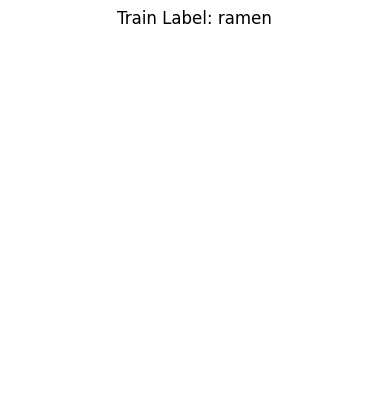

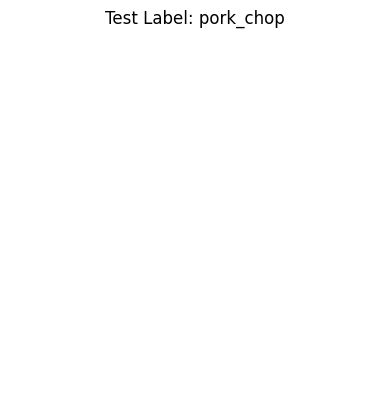

In [ ]:
import tensorflow as tf
import matplotlib.pyplot as plt


def get_label_name(label_number, file_path='/content/food-101/meta/classes.txt'):

  with open(file_path, 'r') as f:
    label_names = f.read().splitlines()
  # Convert the label_number Tensor to a NumPy array and extract the integer value
  label_index = int(label_number.numpy())
  return label_names[label_index]


# Extract a batch of images and labels from the training set
for images, labels in train_data.take(1):
  # Display the first image
  plt.imshow(images[0].numpy())
  # Extract the label number from the one-hot encoded labels
  label_number = tf.argmax(labels[0])
  plt.title(f"Train Label: {(get_label_name(label_number))}")
  plt.axis(False)
  plt.show()

# Extract a batch of images and labels from the test set
for images, labels in test_data.take(1):
  # Display the first image
  plt.imshow(images[0].numpy())
  # Extract the label number from the one-hot encoded labels
  label_number = tf.argmax(labels[0])
  plt.title(f"Test Label: {(get_label_name(label_number))}")
  plt.axis(False)
  plt.show()

In [ ]:
len(labels)

101

In [ ]:
import tensorflow as tf
from tensorflow.python.client import device_lib

physical_devices = tf.config.list_physical_devices('GPU')
print("GPUs available:", physical_devices)


print(device_lib.list_local_devices())

GPUs available: []
[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 12762148221442174388
xla_global_id: -1
]


In [ ]:
import tensorflow as tf
from tensorflow.keras import layers

IMAGE_SHAPE = (224, 224)
BATCH_SIZE = 32

# Data augmentation pipeline
data_augmentation = tf.keras.Sequential([
    layers.RandomFlip("horizontal"),
    layers.RandomRotation(0.2),
    layers.RandomZoom(0.2)
])

# Preprocessing function with data augmentation and normalization
def preprocess_img_with_aug(image, label):
    image = data_augmentation(image)
    image = tf.cast(image, tf.float32) / 255.0  # Normalize image
    return image, label

# Load training data with image resizing
train_data2 = tf.keras.preprocessing.image_dataset_from_directory(
    train_dir,
    label_mode="categorical",
    image_size=IMAGE_SHAPE,  # Resize images to (224, 224)
    batch_size=None
)

# Load test data with image resizing
test_data2 = tf.keras.preprocessing.image_dataset_from_directory(
    test_dir,
    label_mode="categorical",
    image_size=IMAGE_SHAPE,
    batch_size=None
    shuffle=False
# Resize images to (224, 224)
)

# Apply preprocessing, batching, and prefetching
train_data2 = train_data2.map(map_func=preprocess_img_with_aug, num_parallel_calls=tf.data.AUTOTUNE).\
                          shuffle(buffer_size=1000).\
                          batch(BATCH_SIZE).\
                          prefetch(buffer_size=tf.data.AUTOTUNE)

test_data2 = test_data2.map(map_func=preprocess_img_with_aug, num_parallel_calls=tf.data.AUTOTUNE).\
                       batch(BATCH_SIZE).\
                       prefetch(buffer_size=tf.data.AUTOTUNE)


Found 75750 files belonging to 101 classes.
Found 25250 files belonging to 101 classes.


In [ ]:
from tensorflow.keras import mixed_precision, layers
import tensorflow as tf

tf.random.set_seed(42)
mixed_precision.set_global_policy('mixed_float16')

input_shape = (224, 224, 3)
model_res = tf.keras.applications.resnet_v2.ResNet50V2(input_shape=input_shape, include_top=False)
model_res.trainable = True

# Fine-tune from this layer onwards
for layer in model_res.layers[:-20]:  # Unfreeze more layers
    layer.trainable = False

# Define the model architecture
inputs = layers.Input(shape=input_shape, name="input_layer")
x = model_res(inputs)
x = layers.GlobalAveragePooling2D(name="global_average_pooling_layer")(x)
x = layers.Dropout(0.5)(x)  # Add dropout for regularization
outputs = layers.Dense(101, activation='softmax', kernel_regularizer=tf.keras.regularizers.l2(0.001), name="output_layer")(x)

model_res = tf.keras.Model(inputs, outputs)


94668760/94668760 ━━━━━━━━━━━━━━━━━━━━ 5s 0us/step


In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate=1e-4)  # Lower learning rate
optimizer = mixed_precision.LossScaleOptimizer(optimizer)
model_res.compile(optimizer=optimizer,
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])


In [ ]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=1e-6)

history_res = model_res.fit(train_data2,
                            epochs=10,  # Increase epochs to allow more fine-tuning
                            steps_per_epoch=len(train_data2),
                            validation_data=test_data2,
                            validation_steps=int(0.25 * len(test_data2)),
                            callbacks=[early_stopping, reduce_lr, create_tensorboard_callback("transfer_learning", "data augmentation")])

Saving TensorBoard log files to: transfer_learning/data augmentation/20240830-175209
Epoch 1/10
2368/2368 ━━━━━━━━━━━━━━━━━━━━ 1063s 432ms/step - accuracy: 0.2297 - loss: 3.6129 - val_accuracy: 0.5608 - val_loss: 1.8748 - learning_rate: 1.0000e-04
Epoch 2/10


/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


2368/2368 ━━━━━━━━━━━━━━━━━━━━ 74s 31ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.5557 - val_loss: 1.8835 - learning_rate: 1.0000e-04
Epoch 3/10
2368/2368 ━━━━━━━━━━━━━━━━━━━━ 988s 412ms/step - accuracy: 0.4858 - loss: 2.2125 - val_accuracy: 0.5939 - val_loss: 1.7143 - learning_rate: 1.0000e-04
Epoch 4/10
2368/2368 ━━━━━━━━━━━━━━━━━━━━ 70s 30ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.5998 - val_loss: 1.6757 - learning_rate: 1.0000e-04
Epoch 5/10
2368/2368 ━━━━━━━━━━━━━━━━━━━━ 912s 380ms/step - accuracy: 0.5435 - loss: 1.9319 - val_accuracy: 0.6176 - val_loss: 1.7123 - learning_rate: 1.0000e-04
Epoch 6/10
2368/2368 ━━━━━━━━━━━━━━━━━━━━ 71s 30ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.6290 - val_loss: 1.5347 - learning_rate: 1.0000e-04
Epoch 7/10
2368/2368 ━━━━━━━━━━━━━━━━━━━━ 959s 400ms/step - accuracy: 0.5804 - loss: 1.7724 - val_accuracy: 0.6434 - val_loss: 1.4707 - learning_rate: 1.0000e-04
Epoch 8/10
2368/2368 

In [ ]:
model_res.evaluate(test_data2)

790/790 ━━━━━━━━━━━━━━━━━━━━ 281s 355ms/step - accuracy: 0.6496 - loss: 1.4587


[1.459667682647705, 0.6486732959747314]

In [ ]:
model_res.save('resnet_model.h5')

In [ ]:
%load_ext tensorboard
%tensorboard --logdir "transfer_learning/data augmentation/20240830-175209"

<IPython.core.display.Javascript object>

In [ ]:
from google.colab import files
!zip -r tensor_board_resnet.zip "transfer_learning/data augmentation/20240830-175209"
files.download('tensor_board_resnet.zip')

  adding: transfer_learning/data augmentation/20240830-175209/ (stored 0%)
  adding: transfer_learning/data augmentation/20240830-175209/validation/ (stored 0%)
  adding: transfer_learning/data augmentation/20240830-175209/validation/events.out.tfevents.1725041311.6d1243b7cda3.360.1.v2 (deflated 72%)
  adding: transfer_learning/data augmentation/20240830-175209/train/ (stored 0%)
  adding: transfer_learning/data augmentation/20240830-175209/train/events.out.tfevents.1725040329.6d1243b7cda3.360.0.v2 (deflated 93%)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers

IMAGE_SHAPE = (224, 224)
BATCH_SIZE = 32



def preprocess_img(image, label):
    image = tf.cast(image, tf.float32) / 255.0
    return image, label

train_data = tf.keras.preprocessing.image_dataset_from_directory(
    train_dir,
    label_mode="categorical",
    image_size=IMAGE_SHAPE,
    batch_size=None
)

test_data = tf.keras.preprocessing.image_dataset_from_directory(
    test_dir,
    label_mode="categorical",
    image_size=IMAGE_SHAPE,
    batch_size=None,
    shuffle=False

)

train_data = train_data.map(map_func=preprocess_img, num_parallel_calls=tf.data.AUTOTUNE).\
                          shuffle(buffer_size=1000).\
                          batch(BATCH_SIZE).\
                          prefetch(buffer_size=tf.data.AUTOTUNE)

test_data = test_data.map(map_func=preprocess_img, num_parallel_calls=tf.data.AUTOTUNE).\
                       batch(BATCH_SIZE).\
                       prefetch(buffer_size=tf.data.AUTOTUNE)


Found 75750 files belonging to 101 classes.
Found 25250 files belonging to 101 classes.


In [ ]:
from tensorflow.keras import mixed_precision, layers
import tensorflow as tf

tf.random.set_seed(42)
mixed_precision.set_global_policy('mixed_float16')

input_shape = (224, 224, 3)
model_res_v2 = tf.keras.applications.resnet_v2.ResNet50V2(input_shape=input_shape, include_top=False)
model_res_v2.trainable = True

for layer in model_res_v2.layers[:-20]:
    layer.trainable = False

inputs = layers.Input(shape=input_shape, name="input_layer")
x = model_res_v2(inputs)
x = layers.GlobalAveragePooling2D(name="global_average_pooling_layer")(x)
x = layers.Dropout(0.5)(x)
outputs = layers.Dense(101, activation='softmax', kernel_regularizer=tf.keras.regularizers.l2(0.001), name="output_layer")(x)

model_res_v2 = tf.keras.Model(inputs, outputs)
optimizer = tf.keras.optimizers.Adam(learning_rate=1e-4)
optimizer = mixed_precision.LossScaleOptimizer(optimizer)
model_res_v2.compile(optimizer=optimizer,
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])

early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=1e-6)


In [ ]:
history_res = model_res_v2.fit(train_data,
                            epochs=10,
                            steps_per_epoch=len(train_data),
                            validation_data=test_data,
                            validation_steps=int(0.25 * len(test_data)),
                            callbacks=[early_stopping, reduce_lr, create_tensorboard_callback("transfer_learning", "data augmentation")])

Saving TensorBoard log files to: transfer_learning/data augmentation/20240830-211918
Epoch 1/10
2368/2368 ━━━━━━━━━━━━━━━━━━━━ 232s 91ms/step - accuracy: 0.2751 - loss: 3.3737 - val_accuracy: 0.5601 - val_loss: 1.8448 - learning_rate: 1.0000e-04
Epoch 2/10


/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


2368/2368 ━━━━━━━━━━━━━━━━━━━━ 13s 5ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.6632 - val_loss: 1.4573 - learning_rate: 1.0000e-04
Epoch 3/10
2368/2368 ━━━━━━━━━━━━━━━━━━━━ 232s 86ms/step - accuracy: 0.5809 - loss: 1.7841 - val_accuracy: 0.6858 - val_loss: 1.3398 - learning_rate: 1.0000e-04
Epoch 4/10
2368/2368 ━━━━━━━━━━━━━━━━━━━━ 12s 5ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.6361 - val_loss: 1.4761 - learning_rate: 1.0000e-04
Epoch 5/10
2368/2368 ━━━━━━━━━━━━━━━━━━━━ 230s 96ms/step - accuracy: 0.7063 - loss: 1.2416 - val_accuracy: 0.8529 - val_loss: 1.0816 - learning_rate: 1.0000e-04
Epoch 6/10
2368/2368 ━━━━━━━━━━━━━━━━━━━━ 13s 5ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.5895 - val_loss: 1.7911 - learning_rate: 1.0000e-04
Epoch 7/10
2368/2368 ━━━━━━━━━━━━━━━━━━━━ 232s 89ms/step - accuracy: 0.8229 - loss: 0.7917 - val_accuracy: 0.6693 - val_loss: 1.5377 - learning_rate: 1.0000e-04
Epoch 8/10
2368/2368 ━━━━━━

In [ ]:
model_res_v2.evaluate(test_data)

790/790 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.6108 - loss: 1.8217


[1.685801386833191, 0.6354851722717285]

In [ ]:
from tensorflow.keras import mixed_precision, layers
import tensorflow as tf

tf.random.set_seed(42)
mixed_precision.set_global_policy('mixed_float16')

input_shape = (224, 224, 3)
model_res_v3 = tf.keras.applications.resnet_v2.ResNet50V2(input_shape=input_shape, include_top=False)
model_res_v3.trainable = True

for layer in model_res_v3.layers[:-10]:
    layer.trainable = False

inputs = layers.Input(shape=input_shape, name="input_layer")
x = model_res_v3(inputs)
x = layers.GlobalAveragePooling2D(name="global_average_pooling_layer")(x)
outputs = layers.Dense(101, activation='softmax', name="output_layer")(x)

model_res_v3 = tf.keras.Model(inputs, outputs)
optimizer = tf.keras.optimizers.Adam(learning_rate=1e-4)
optimizer = mixed_precision.LossScaleOptimizer(optimizer)
model_res_v3.compile(optimizer=optimizer,
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])

early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=1e-6)


In [ ]:
history_res_v3 = model_res_v3.fit(train_data,
                            epochs=10,
                            steps_per_epoch=len(train_data),
                            validation_data=test_data,
                            validation_steps=int(0.25 * len(test_data)),
                            callbacks=[early_stopping, reduce_lr, create_tensorboard_callback("transfer_learning", "data augmentation")])

Saving TensorBoard log files to: transfer_learning/data augmentation/20240831-121809
Epoch 1/10
2368/2368 ━━━━━━━━━━━━━━━━━━━━ 247s 97ms/step - accuracy: 0.3341 - loss: 2.9119 - val_accuracy: 0.5220 - val_loss: 1.8660 - learning_rate: 1.0000e-04
Epoch 2/10


/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


2368/2368 ━━━━━━━━━━━━━━━━━━━━ 13s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.6244 - val_loss: 1.4449 - learning_rate: 1.0000e-04
Epoch 3/10
2368/2368 ━━━━━━━━━━━━━━━━━━━━ 221s 92ms/step - accuracy: 0.5846 - loss: 1.6427 - val_accuracy: 0.6536 - val_loss: 1.3591 - learning_rate: 1.0000e-04
Epoch 4/10
2368/2368 ━━━━━━━━━━━━━━━━━━━━ 13s 5ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.5871 - val_loss: 1.5046 - learning_rate: 1.0000e-04
Epoch 5/10
2368/2368 ━━━━━━━━━━━━━━━━━━━━ 299s 113ms/step - accuracy: 0.6696 - loss: 1.2870 - val_accuracy: 0.7059 - val_loss: 1.4648 - learning_rate: 1.0000e-04
Epoch 6/10
2368/2368 ━━━━━━━━━━━━━━━━━━━━ 13s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.5609 - val_loss: 1.6972 - learning_rate: 1.0000e-04
Epoch 7/10
2368/2368 ━━━━━━━━━━━━━━━━━━━━ 231s 96ms/step - accuracy: 0.7445 - loss: 1.0152 - val_accuracy: 0.6488 - val_loss: 1.3566 - learning_rate: 1.0000e-04
Epoch 8/10
2368/2368 ━━━━━

In [ ]:
model_res_v3.evaluate(test_data)

790/790 ━━━━━━━━━━━━━━━━━━━━ 58s 73ms/step - accuracy: 0.5987 - loss: 1.5603


[1.4966135025024414, 0.6131089329719543]

In [ ]:
predicted_probability = model_res_v3.predict(test_data)

790/790 ━━━━━━━━━━━━━━━━━━━━ 59s 67ms/step


In [ ]:
predicted_labels = np.argmax(predicted_probability, axis=-1)
predicted_labels[:10]

array([52,  0,  8,  8,  0, 26, 22,  0,  2, 41])

In [ ]:
true_labels = []
for images, labels in test_data.unbatch():
  true_labels.append(labels.numpy().argmax())
true_labels[:10]

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0]

In [ ]:
from sklearn.metrics import precision_score, recall_score, f1_score
precision = precision_score(true_labels, predicted_labels, average='weighted')
recall = recall_score(true_labels, predicted_labels, average='weighted')
f1 = f1_score(true_labels, predicted_labels, average='weighted')
print(f'Precision: {precision}')
print(f'Recall: {recall}')
print(f'F1 Score: {f1}')

Precision: 0.625583032081916
Recall: 0.6131089108910891
F1 Score: 0.6098929997318193


In [ ]:
with open('/content/food-101/meta/classes.txt', 'r') as file:
  lines = file.readlines()
classes = []

for line in lines:
  classes.append(line.strip())

In [ ]:
make_confusion_matrix(
    y_true=true_labels,
    y_pred=predicted_labels,
    classes=classes,
    figsize=(100, 100),
    text_size=20,
    norm=False,
    savefig=True
)

In [ ]:
%load_ext tensorboard
%tensorboard --logdir "transfer_learning/data augmentation/20240831-121809"

<IPython.core.display.Javascript object>

In [ ]:
model_res_v3.summary()

Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ resnet50v2 (Functional)              │ (None, 7, 7, 2048)          │      23,564,800 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling_layer         │ (None, 2048)                │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ output_layer (Dense)                 │ (None, 101)                 │         206,949 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 31,017,781 (118.32 MB)

 Trainable params: 3,623,013 (13.82 MB)

 Non-trainable params: 20,148,736 (76.86 MB)

 Optimizer params: 7,246,032 (27.64 MB)

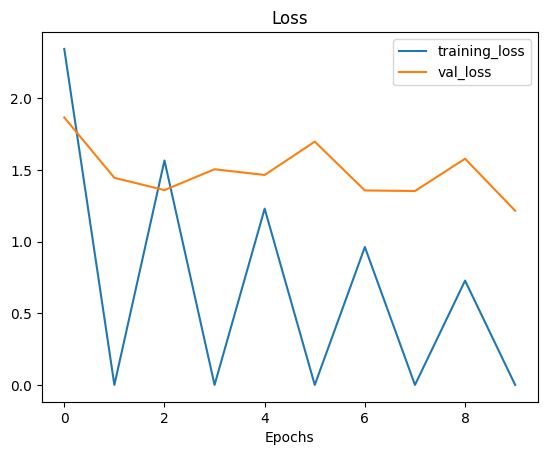

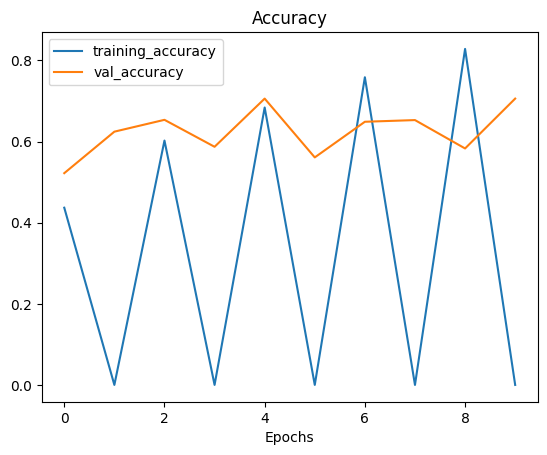

In [ ]:
plot_loss_curves(history_res_v3)

In [ ]:
with open('/content/food-101/meta/labels.txt', 'r') as file:
  lines = file.readlines()
class_names = []

for line in lines:
  class_names.append(line.strip())